## Labels and Image Data Preprocessing

#### Read the dataset labels

In [ ]:
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt
from keras.preprocessing import image
import keras
from sklearn import preprocessing

# define the base directory and the label files that will be used in the trainning
base_dir = '.\data'
images_path='.\data\clean_images'
train_labels_file = 'images_manufacturer_train.txt'
test_labels_file = 'images_manufacturer_test.txt'
validation_labels_file = 'images_manufacturer_val.txt'

# read the label files
path = os.path.join(base_dir,train_labels_file )
train_labels = pd.read_csv(path, sep='\r', lineterminator='\n',header=None,names=['label_text'])
path = os.path.join(base_dir,test_labels_file )
test_labels = pd.read_csv(path, sep='\r', lineterminator='\n',header=None,names=['label_text'])
path = os.path.join(base_dir,validation_labels_file )
validation_labels = pd.read_csv(path, sep='\r', lineterminator='\n',header=None,names=['label_text'])

# merge the train_labels and the test_labels to create a larger training dataset
model_train_labels = [train_labels,test_labels]
train_labels = pd.concat(model_train_labels)

### Inspect the label file content

In [102]:
train_labels[:10]

,label_text
0,1025794 Boeing
1,1340192 Boeing
2,0056978 Boeing
3,0698580 Boeing
4,0450014 Boeing
5,1042824 Boeing
6,0894380 Boeing
7,1427680 Boeing
8,0817494 Boeing
9,0716386 Boeing


In [103]:
type(train_labels)

pandas.core.frame.DataFrame

#### Define helper methods to read an image from disk and resize it 

In [2]:
from PIL import Image
import numpy as np

# reads an image from disk - resizes the output and returns an array representation of the image
def read_image(file_name, target_size=(200,200)):
    im = image.load_img(file_name, target_size=target_size)
    return image.img_to_array(im)

#### Define helper methods to parse a label text 

In [3]:
def extractLabelFromTxt(txt):
    parts = txt.split(' ')
    if len(parts) > 2:
        return  parts[0], parts[1] +' '+ parts[2] 
    # return parsed image name and aircraft family parts
    return parts[0], parts[1]

#### Define helper methods to filter and parse a given labels list returning only the given the matching label names and image names for the given classes

In [4]:
# returns only the labels and the image name matching the passed filter_by_labels name
def filter_labels_by_name(labels, filter_by_labels):
    filtered_labels =[]
    for index, labelObj in labels.iterrows():
        image_name, label = extractLabelFromTxt(labelObj['label_text'])
        if(label in filter_by_labels):    
            filtered_labels.append(labelObj)
    return filtered_labels;

#### Define a helper method to load the image data and encoded labels for a given label list

In [ ]:
# returns the data and labels for a givel lable object list
def get_model_data_and_labels(labels):
    le = preprocessing.LabelEncoder()
    set_labels =[]
    set_data = []
    for labelObj in labels:
        #extract the labels and image file names
        image_name, label = extractLabelFromTxt(labelObj['label_text'])
        set_labels.append(label)
        # extract the images
        image_name_with_ext = image_name+'.jpg'
        image_file = os.path.join(images_path,image_name_with_ext)
        image_data = read_image(image_file)
        set_data.append(image_data)
           
    le.fit(set_labels)
    #print(le.classes_)
    # return the dataset and encoded labels
    return np.array(set_data),le.transform(set_labels);

#### Extract the test, trainning and validation dataset

In [114]:
# the Aircraft manifacturer classes to extract 
manifacturer_classes = ['Boeing','Airbus']

filtered_test_labels = filter_labels_by_name(test_labels, manifacturer_classes)
filtered_train_labels = filter_labels_by_name(train_labels,manifacturer_classes)
filtered_validation_labels = filter_labels_by_name(validation_labels, manifacturer_classes)

#### Inspect the filtered labels

In [6]:
len(filtered_test_labels)

1167

In [7]:
len(filtered_train_labels)

2334

In [8]:
len(filtered_validation_labels)

1166

In [104]:
filtered_train_labels[0]['label_text']

'1025794 Boeing'

## Load the training and validation data and labels

In [ ]:
# the trainning data and labels
x,y= get_model_data_and_labels(filtered_train_labels)

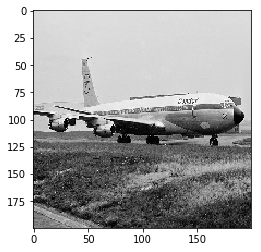

In [164]:
# inspect the first image
plt.imshow(image.array_to_img(x[0]))

In [162]:
print(y[0])

1


In [10]:
# the validation data and labels
x_val,y_val= get_model_data_and_labels(filtered_validation_labels)

['Airbus' 'Boeing']


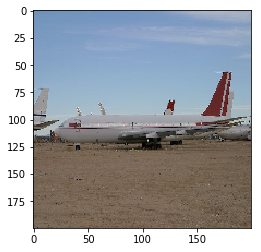

In [105]:
# inspect the fist image
plt.imshow(image.array_to_img(x_val[0]))

In [109]:
# inspect the data input shape 
x[0].shape

(200, 200, 3)

## Build the Model

In [11]:
from keras import layers
from keras import models
from keras import optimizers

model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu',
                        input_shape=(200, 200, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

In [12]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 198, 198, 32)      896       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 99, 99, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 97, 97, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 48, 48, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 46, 46, 128)       73856     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 23, 23, 128)       0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 21, 21, 128)       147584    
__________

#### Define the image data generators for the trainning and validation sets

In [13]:
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(
    rescale=1./255, 
    #rotation_range=40,
    #height_shift_range=0.2,
    #shear_range=0.2,
    #zoom_range=0.2,
    horizontal_flip=True,)

# do not augment the test data
test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow(x,y)
validation_generator = test_datagen.flow(x_val, y_val)

### Train the model for 50 epochs

In [14]:
history = model.fit_generator(
      train_generator,
      steps_per_epoch=100,
      epochs=50,
      validation_data=validation_generator,
      validation_steps=50)

Epoch 1/50
100/100 [==============================] - 27s 267ms/step - loss: 0.6595 - acc: 0.6276 - val_loss: 0.6601 - val_acc: 0.6271
Epoch 2/50
100/100 [==============================] - 23s 234ms/step - loss: 0.6505 - acc: 0.6268 - val_loss: 0.6312 - val_acc: 0.6441
Epoch 3/50
100/100 [==============================] - 23s 234ms/step - loss: 0.6251 - acc: 0.6529 - val_loss: 0.6270 - val_acc: 0.6522
Epoch 4/50
100/100 [==============================] - 23s 234ms/step - loss: 0.6103 - acc: 0.6634 - val_loss: 0.6391 - val_acc: 0.6460
Epoch 5/50
100/100 [==============================] - 23s 234ms/step - loss: 0.5922 - acc: 0.6848 - val_loss: 0.5916 - val_acc: 0.6979
Epoch 6/50
100/100 [==============================] - 23s 235ms/step - loss: 0.5689 - acc: 0.7055 - val_loss: 0.5934 - val_acc: 0.6931
Epoch 7/50
100/100 [==============================] - 23s 235ms/step - loss: 0.5443 - acc: 0.7222 - val_loss: 0.5851 - val_acc: 0.6846
Epoch 8/50
100/100 [==============================] - 2

#### Save the trained model

In [15]:
model.save('model.h5')

#### Plot the trainning history

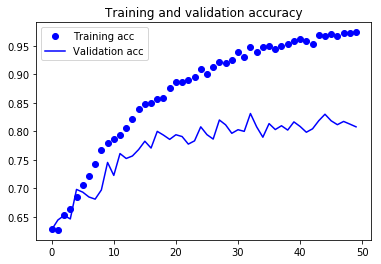

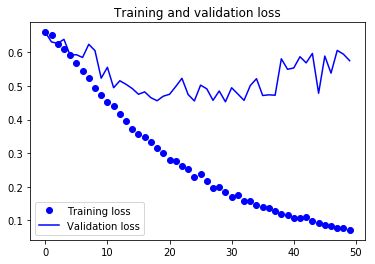

In [16]:
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

## Test the model results

#### manually fetched aircraft images from google to triple check the model results!

In [122]:
# define a label encoder to decode the results
le = preprocessing.LabelEncoder()
le.fit(manifacturer_classes)
le.classes_
#le.inverse_transform([0])

array(['Airbus', 'Boeing'], dtype='<U6')

In [321]:
test_img_path = 'should_be_airbus_a380.jpg'
test_image = Image.open(test_img_path)

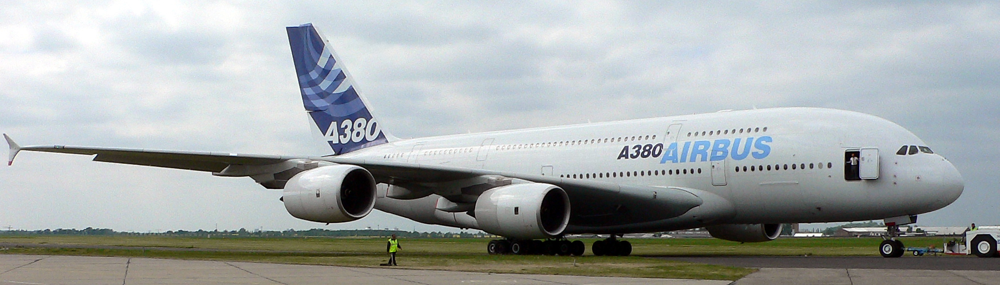

In [322]:
test_image

In [317]:
test_image_data =  read_image(test_img_path)

In [323]:
test_image_data =  read_image(test_img_path)
test_image_data = np.array(test_image_data/255)
test_image_data = test_image_data.reshape((1,) + test_image_data.shape)
preds = model.predict(test_image_data)
pred = [int(np.rint(preds[0][0]))]
print('predected: {0}'.format(le.inverse_transform(pred)))

predected: ['Airbus']


c:\users\khali\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


## Visualizing the output and Plotting the heatmap over the original image

In [301]:
from keras import backend as K
import cv2


def apply_heatmap(test_imag_path):
    last_conv_layer = model.get_layer('conv2d_4')

    model_output = model.output[0][0]
    #This is the gradient of the "boeing" class with regard to
    # the output feature map of `conv2d_4`
    grads = K.gradients(model_output, last_conv_layer.output)[0]

    # This is a vector of shape (128,), where each entry
    # is the mean intensity of the gradient over a specific feature map channel
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

    # This function allows us to access the values of the quantities we just defined:
    # `pooled_grads` and the output feature map of `conv2d_4`,
    # given a sample image
    iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])

    # These are the values of these two quantities, as Numpy arrays,
    # given our sample image of a boeing aircraft
    pooled_grads_value, conv_layer_output_value = iterate([test_image_data])

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the boeing class
    for i in range(128):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

    # The channel-wise mean of the resulting feature map
    # is our heatmap of class activation
    heatmap = np.mean(conv_layer_output_value, axis=-1)

    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)

    # We use cv2 to load the original image
    img = cv2.imread(test_img_path)

    # We resize the heatmap to have the same size as the original image
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    # We convert the heatmap to RGB
    heatmap = np.uint8(255 * heatmap)

    # We apply the heatmap to the original image
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # 0.4 here is a heatmap intensity factor
    superimposed_img = heatmap * 0.4 + img

    # Save the image to disk
    cv2.imwrite('_heat_map_'+test_imag_path , superimposed_img)
    heatmapped_image =  Image.open('_heat_map_'+test_imag_path)
    return heatmapped_image

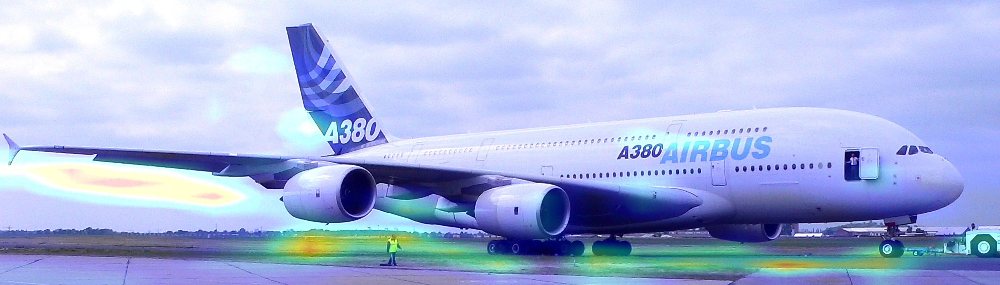

In [324]:
apply_heatmap(test_img_path)

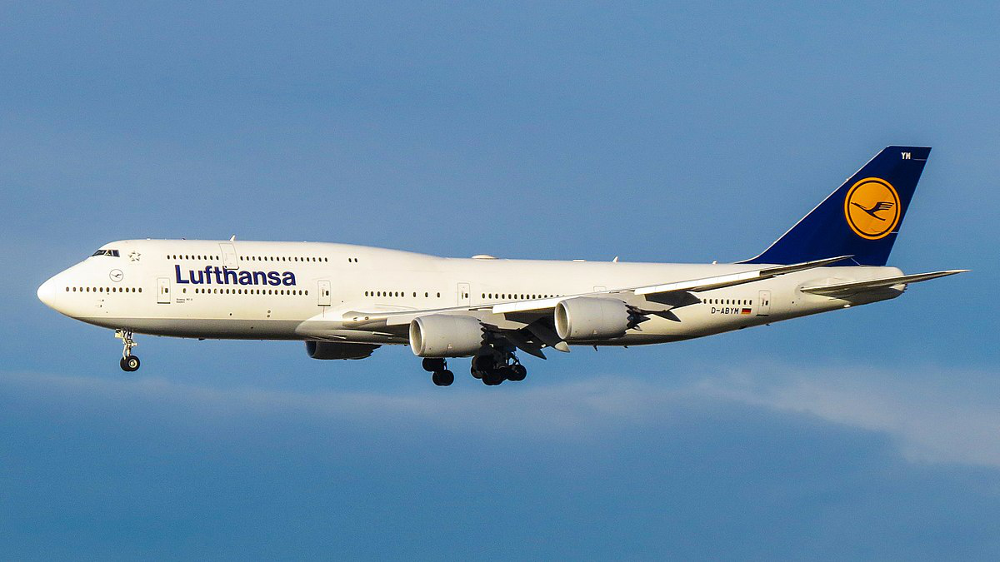

In [325]:
test_img_path = 'should_be_boeing_747.jpg'
test_image = Image.open(test_img_path)
test_image

In [326]:
test_image_data =  read_image(test_img_path)
test_image_data = np.array(test_image_data/255)
test_image_data = test_image_data.reshape((1,) + test_image_data.shape)
preds = model.predict(test_image_data)
pred = [int(np.rint(preds[0][0]))]
print('predicted: {0}'.format(le.inverse_transform(pred)))

predicted: ['Boeing']


c:\users\khali\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


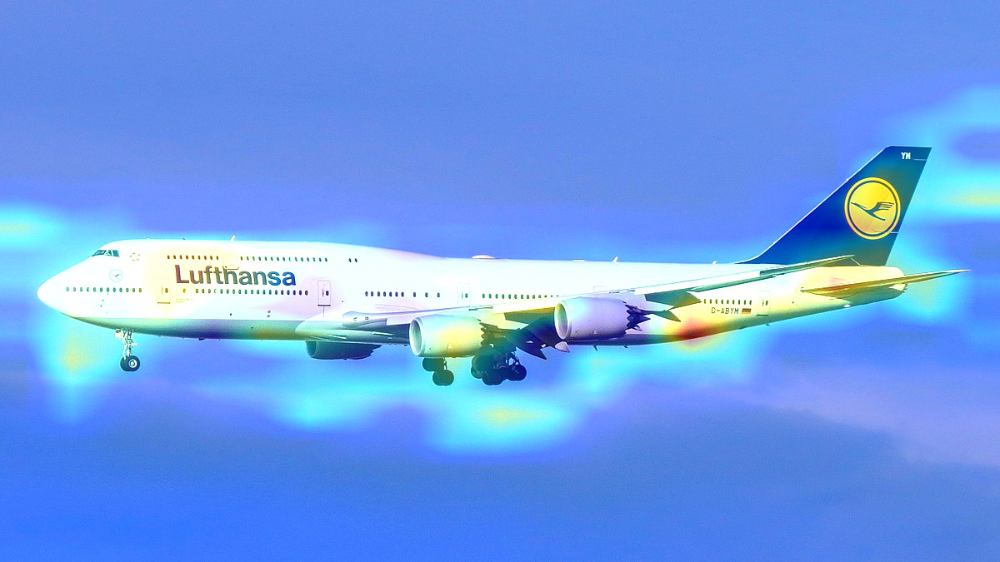

In [327]:
apply_heatmap(test_img_path)

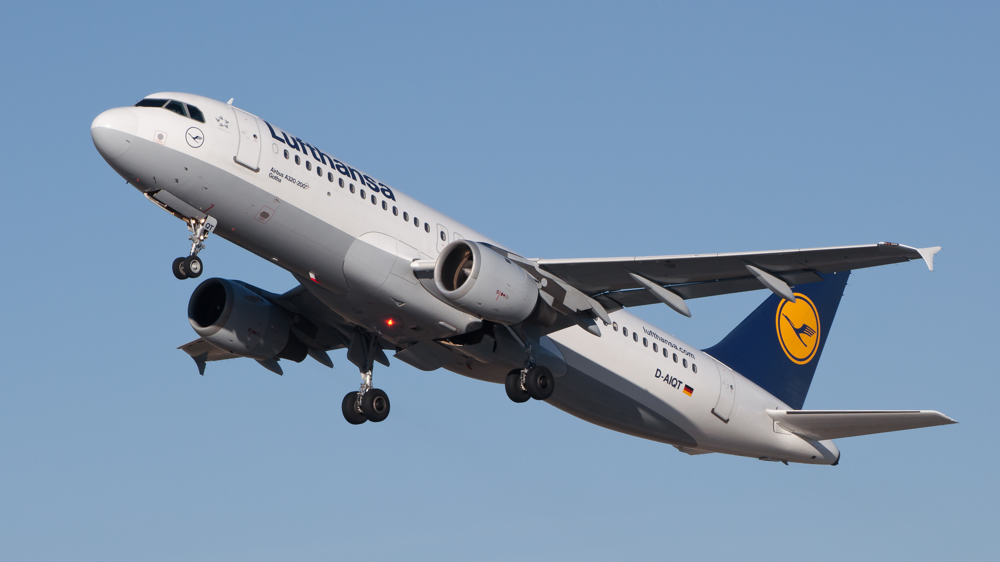

In [308]:
test_img_path = 'Airbus_A320-211.jpg'
test_image = Image.open(test_img_path)
test_image

In [309]:
test_image_data =  read_image(test_img_path)
test_image_data = np.array(test_image_data/255)
test_image_data = test_image_data.reshape((1,) + test_image_data.shape)
preds = model.predict(test_image_data)
pred = [int(np.rint(preds[0][0]))]
print('predicted: {0}'.format(le.inverse_transform(pred)))

predicted: ['Airbus']


c:\users\khali\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


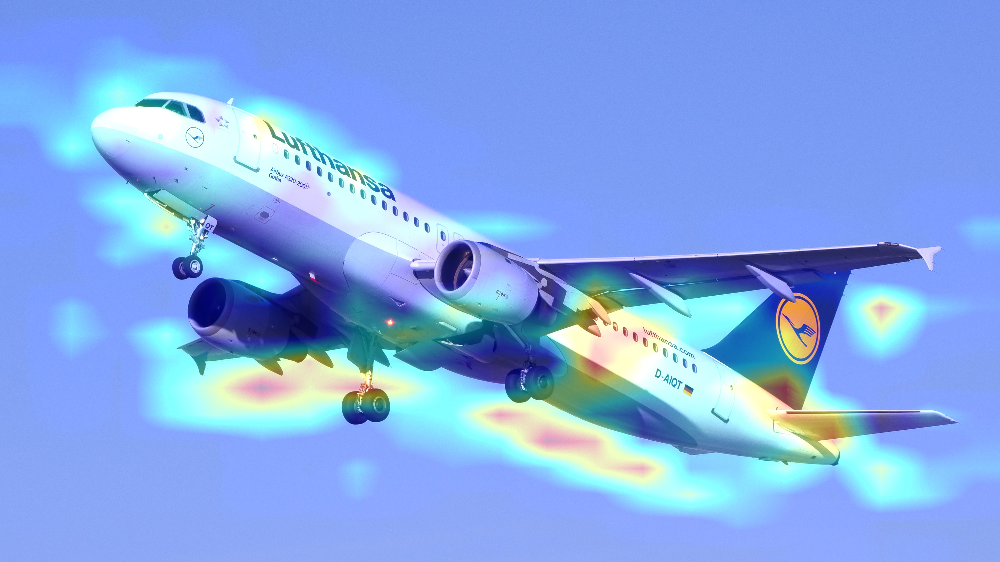

In [310]:
apply_heatmap(test_img_path)

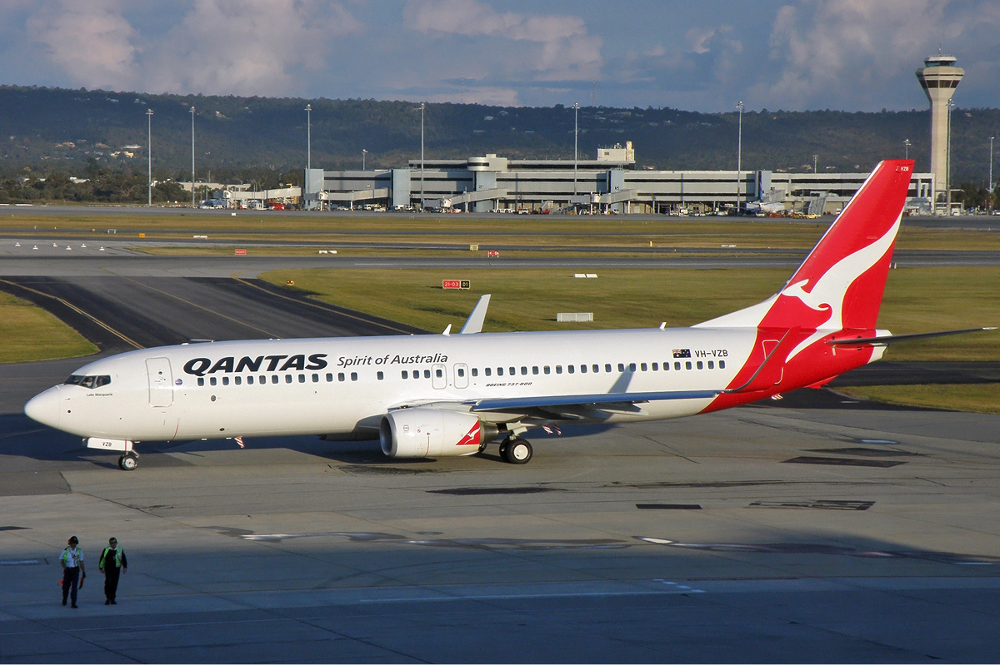

In [311]:
test_img_path = 'Boeing_737-800.jpg'
test_image = Image.open(test_img_path)
test_image

In [312]:
test_image_data =  read_image(test_img_path)
test_image_data = np.array(test_image_data/255)
test_image_data = test_image_data.reshape((1,) + test_image_data.shape)
preds = model.predict(test_image_data)
pred = [int(np.rint(preds[0][0]))]
print('predected: {0}'.format(le.inverse_transform(pred)))

predected: ['Boeing']


c:\users\khali\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


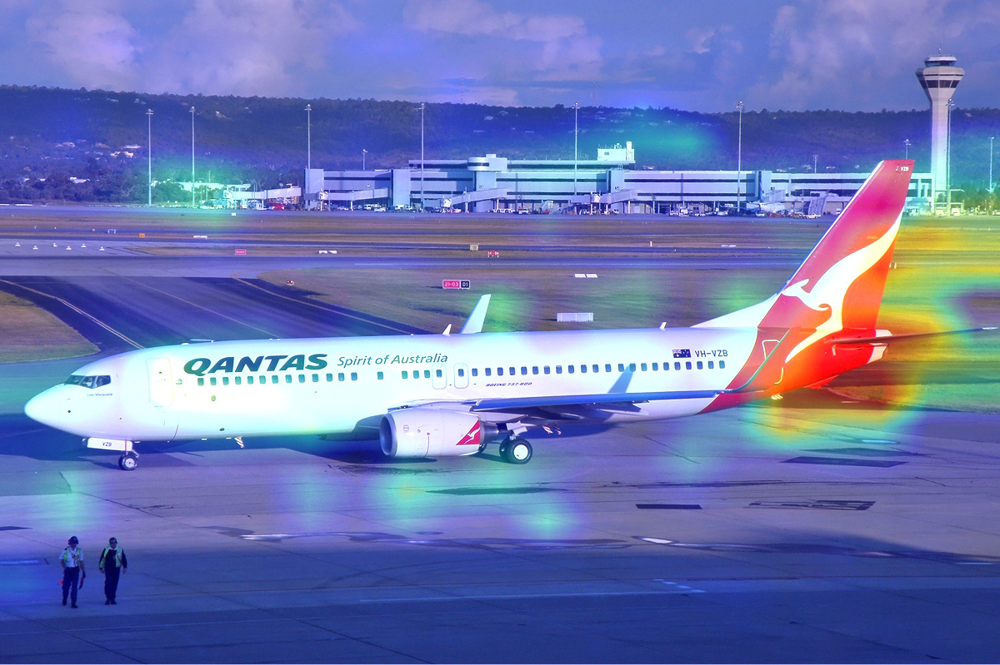

In [313]:
apply_heatmap(test_img_path)